In [ ]:
import os
import nibabel as nib
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import torch.nn.functional as F
import torch.utils.checkpoint as checkpoint
import torchio as tio
from scipy.ndimage import zoom
from monai.transforms import RandFlip, RandRotate, RandZoom, RandGaussianNoise
from monai.networks.nets import AttentionUnet
from tqdm import tqdm
import matplotlib.pyplot as plt
from scipy.ndimage import binary_fill_holes, binary_closing, label, gaussian_filter
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats
from statsmodels.stats.multicomp import pairwise_tukeyhsd
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score

KeyboardInterrupt: 

In [ ]:
image_dir = r"E:\image"
mask_dir = r"E:\mask"

TARGET_SHAPE = (128, 128, 128)  

def load_nifti(file_path):
    nifti_img = nib.load(file_path) 
    img_array = np.array(nifti_img.get_fdata(), dtype=np.float32) 
    return img_array

def resize_volume(volume, target_shape=TARGET_SHAPE):
    zoom_factors = [t / s for t, s in zip(target_shape, volume.shape)]
    resized_volume = zoom(volume, zoom_factors, order=1) 
    return resized_volume

class NiftiDataset(Dataset):
    def __init__(self, image_dir, mask_dir, target_shape=TARGET_SHAPE, augment=False):
        self.image_files = sorted(os.listdir(image_dir))
        self.mask_files = sorted(os.listdir(mask_dir))
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.target_shape = target_shape
        self.augment = augment

        self.augmentations = [
            RandFlip(prob=0.5, spatial_axis=0),
            RandRotate(range_x=0.1, prob=0.5),
            RandZoom(min_zoom=0.9, max_zoom=1.1, prob=0.5),
            RandGaussianNoise(prob=0.2, mean=0.0, std=0.1)
        ]

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_path = os.path.join(self.image_dir, self.image_files[idx])
        mask_path = os.path.join(self.mask_dir, self.mask_files[idx])

        image = load_nifti(img_path)
        mask = load_nifti(mask_path)

        image = (image - np.min(image)) / (np.max(image) - np.min(image) + 1e-8)

        image = resize_volume(image, self.target_shape)
        mask = resize_volume(mask, self.target_shape)

        image = torch.tensor(image, dtype=torch.float32).unsqueeze(0)  # Shape: (1, H, W, D)
        mask = torch.tensor(mask, dtype=torch.float32).unsqueeze(0)

        if self.augment:
            for transform in self.augmentations:
                image = transform(image)  
                mask = transform(mask) 

        return image, mask

train_dataset = NiftiDataset(image_dir, mask_dir, augment=True)
train_dataloader = DataLoader(train_dataset, batch_size=1, shuffle=True)

print(f"Training set size: {len(train_dataset)}")

for images, masks in train_dataloader:
    print(f"Image Shape: {images.shape}, Mask Shape: {masks.shape}")
    break  # Check only one batch

Training set size: 436
Image Shape: torch.Size([1, 1, 128, 128, 128]), Mask Shape: torch.Size([1, 1, 128, 128, 128])


In [ ]:
image_dir = r"E:\valid\image"
mask_dir = r"E:\valid\mask"

TARGET_SHAPE = (128, 128, 128)  

def load_nifti(file_path):
    nifti_img = nib.load(file_path)  
    img_array = np.array(nifti_img.get_fdata(), dtype=np.float32) 
    return img_array

def resize_volume(volume, target_shape=TARGET_SHAPE):
    zoom_factors = [t / s for t, s in zip(target_shape, volume.shape)]
    resized_volume = zoom(volume, zoom_factors, order=1)  
    return resized_volume

class NiftiDataset(Dataset):
    def __init__(self, image_dir, mask_dir, target_shape=TARGET_SHAPE, augment=False):
        self.image_files = sorted(os.listdir(image_dir))
        self.mask_files = sorted(os.listdir(mask_dir))
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.target_shape = target_shape
        self.augment = augment

        self.augmentations = [
            RandFlip(prob=0.5, spatial_axis=0),
            RandRotate(range_x=0.1, prob=0.5),
            RandZoom(min_zoom=0.9, max_zoom=1.1, prob=0.5),
            RandGaussianNoise(prob=0.2, mean=0.0, std=0.1)
        ]

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_path = os.path.join(self.image_dir, self.image_files[idx])
        mask_path = os.path.join(self.mask_dir, self.mask_files[idx])

        image = load_nifti(img_path)
        mask = load_nifti(mask_path)

        image = (image - np.min(image)) / (np.max(image) - np.min(image) + 1e-8)

        image = resize_volume(image, self.target_shape)
        mask = resize_volume(mask, self.target_shape)

        image = torch.tensor(image, dtype=torch.float32).unsqueeze(0)  # Shape: (1, H, W, D)
        mask = torch.tensor(mask, dtype=torch.float32).unsqueeze(0)

        if self.augment:
            for transform in self.augmentations:
                image = transform(image)
                mask = transform(mask) 

        return image, mask

val_dataset = NiftiDataset(image_dir, mask_dir, augment=True)
val_dataloader = DataLoader(val_dataset, batch_size=1, shuffle=True)

print(f"Validation set size: {len(val_dataset)}")

for images, masks in val_dataloader:
    print(f"Image Shape: {images.shape}, Mask Shape: {masks.shape}")
    break  # Check only one batch

Validation set size: 144
Image Shape: torch.Size([1, 1, 128, 128, 128]), Mask Shape: torch.Size([1, 1, 128, 128, 128])


In [ ]:
model = AttentionUnet(
    spatial_dims=3,  
    in_channels=1,  
    out_channels=3,  
    channels=(16, 32, 64, 128, 256),  
    strides=(2, 2, 2, 2), 
    dropout=0.3  
)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

print(model)

AttentionUnet(
  (model): Sequential(
    (0): ConvBlock(
      (conv): Sequential(
        (0): Convolution(
          (conv): Conv3d(1, 16, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1))
          (adn): ADN(
            (N): BatchNorm3d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (D): Dropout(p=0.3, inplace=False)
            (A): ReLU()
          )
        )
        (1): Convolution(
          (conv): Conv3d(16, 16, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1))
          (adn): ADN(
            (N): BatchNorm3d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (D): Dropout(p=0.3, inplace=False)
            (A): ReLU()
          )
        )
      )
    )
    (1): AttentionLayer(
      (attention): AttentionBlock(
        (W_g): Sequential(
          (0): Convolution(
            (conv): Conv3d(16, 8, kernel_size=(1, 1, 1), stride=(1, 1, 1))
          )
          (1): BatchNorm3d(8, eps=1e-05

In [ ]:
def combined_loss(pred, target):
    ce_loss = nn.CrossEntropyLoss()(pred, target)
    return ce_loss 

optimizer = optim.AdamW(model.parameters(), lr=1e-4, weight_decay=5e-4) 

scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode="min", factor=0.3, patience=3)

In [ ]:
# Function to save checkpoint
def save_checkpoint(model, optimizer, scaler, epoch, loss, filepath="checkpoint.pth"):
    checkpoint = {
        "epoch": epoch,
        "model_state_dict": model.state_dict(),
        "optimizer_state_dict": optimizer.state_dict(),
        "scaler_state_dict": scaler.state_dict(),
        "loss": loss,
    }
    torch.save(checkpoint, filepath)
    print(f"Checkpoint saved at epoch {epoch+1}")

# Function to load checkpoint
def load_checkpoint(model, optimizer, scaler, filepath="checkpoint.pth"):
    if os.path.exists(filepath):
        checkpoint = torch.load(filepath, map_location=device)
        model.load_state_dict(checkpoint["model_state_dict"])
        optimizer.load_state_dict(checkpoint["optimizer_state_dict"])
        scaler.load_state_dict(checkpoint["scaler_state_dict"])
        start_epoch = checkpoint["epoch"] + 1
        best_loss = checkpoint["loss"]
        print(f"Resuming from epoch {start_epoch} with loss {best_loss:.4f}")
        return model, optimizer, scaler, start_epoch, best_loss
    else:
        print("No checkpoint found, starting fresh!")
        return model, optimizer, scaler, 0, float("inf") 

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

scaler = torch.amp.GradScaler()

best_val_loss = float("inf")
early_stopping_counter = 0
patience = 2  

num_epochs = 10 
grad_accumulation_steps = 4 
best_loss = float("inf") 

model, optimizer, scaler, start_epoch, best_loss = load_checkpoint(model, optimizer, scaler)

for epoch in range(start_epoch, num_epochs):
    model.train()
    epoch_loss = 0

    loop = tqdm(train_dataloader, desc=f"Epoch {epoch+1}/{num_epochs}", leave=False)

    for batch_idx, (images, masks) in enumerate(loop):
        images = images.to(device, dtype=torch.float32)
        masks = masks.to(device, dtype=torch.long) 
        masks = masks.squeeze(1) 

        optimizer.zero_grad(set_to_none=True)

        with torch.autocast(device_type="cuda", dtype=torch.float16):
            outputs = model(images)  # Forward pass
            loss = combined_loss(outputs, masks)

        loss = loss / grad_accumulation_steps
        scaler.scale(loss).backward()

        if (batch_idx + 1) % grad_accumulation_steps == 0 or batch_idx == len(train_dataloader) - 1:
            scaler.step(optimizer) 
            scaler.update()
            optimizer.zero_grad(set_to_none=True) 

        epoch_loss += loss.item()
        loop.set_postfix(loss=loss.item()) 

        # Free up memory
        del images, masks, outputs, loss
        torch.cuda.empty_cache()

    avg_train_loss = epoch_loss / len(train_dataloader)
    print(f"Epoch {epoch+1}/{num_epochs}, Avg Training Loss: {avg_train_loss:.4f}")


    if (epoch + 1) % 5 == 0 or avg_train_loss < best_loss:
        save_checkpoint(model, optimizer, scaler, epoch, avg_train_loss, "checkpoint.pth")
        best_loss = min(best_loss, avg_train_loss) 

    # **Validation Loop**
    model.eval()
    total_val_loss = 0.0

    with torch.no_grad():
        val_loop = tqdm(val_dataloader, desc=f"Validating...", leave=False)
        for images, masks in val_loop:
            images = images.to(device, dtype=torch.float32)
            masks = masks.to(device, dtype=torch.long)
            masks = masks.squeeze(1)

            outputs = model(images)
            val_loss = combined_loss(outputs, masks)
            total_val_loss += val_loss.item()

            del images, masks, outputs, val_loss
            torch.cuda.empty_cache()

    avg_val_loss = total_val_loss / len(val_dataloader)
    print(f"Epoch {epoch+1}: Validation Loss: {avg_val_loss:.4f}")

    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        early_stopping_counter = 0
        torch.save(model.state_dict(), "best_model.pth")
        print(" Model improved. Saving best model.")
    else:
        early_stopping_counter += 1
        print(f" Validation loss did not improve ({early_stopping_counter}/{patience})")

    if early_stopping_counter >= patience:
        print(" Early stopping triggered. Stopping training.")
        break 

    scheduler.step(avg_val_loss)

print("Training complete!")

c:\Users\NARINDER\Desktop\Assignment_AI\ai\Lib\site-packages\torch\amp\grad_scaler.py:132: UserWarning: torch.cuda.amp.GradScaler is enabled, but CUDA is not available.  Disabling.
  warnings.warn(


🚀 No checkpoint found, starting fresh!


Epoch 1/10:   0%|          | 0/436 [00:00<?, ?it/s]c:\Users\NARINDER\Desktop\Assignment_AI\ai\Lib\site-packages\torch\amp\autocast_mode.py:266: UserWarning: User provided device_type of 'cuda', but CUDA is not available. Disabling
  warnings.warn(


KeyboardInterrupt: 

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Mixed Precision Training
scaler = torch.amp.GradScaler()

best_val_loss = float("inf")
early_stopping_counter = 0
patience = 2 

num_epochs = 10 
grad_accumulation_steps = 4 
best_loss = float("inf")  

model, optimizer, scaler, start_epoch, best_loss = load_checkpoint(model, optimizer, scaler)

model.train()
epoch_loss = 0

loop = tqdm(train_dataloader, desc=f"Epoch {epoch+1}/{num_epochs}", leave=False)

for batch_idx, (images, masks) in enumerate(loop):
    images = images.to(device, dtype=torch.float32)
    masks = masks.to(device, dtype=torch.long) 
    masks = masks.squeeze(1)  

    optimizer.zero_grad(set_to_none=True)

    with torch.autocast(device_type="cuda", dtype=torch.float16):
        outputs = model(images)
        loss = combined_loss(outputs, masks) 

    loss = loss / grad_accumulation_steps
    scaler.scale(loss).backward()

    if (batch_idx + 1) % grad_accumulation_steps == 0 or batch_idx == len(train_dataloader) - 1:
        scaler.step(optimizer) 
        scaler.update()
        optimizer.zero_grad(set_to_none=True) 

    epoch_loss += loss.item()
    loop.set_postfix(loss=loss.item()) 

    # Free up memory
    del images, masks, outputs, loss
    torch.cuda.empty_cache()

avg_train_loss = epoch_loss / len(train_dataloader)
print(f"Epoch {epoch+1}/{num_epochs}, Avg Training Loss: {avg_train_loss:.4f}")

if (epoch + 1) % 5 == 0 or avg_train_loss < best_loss:
    save_checkpoint(model, optimizer, scaler, epoch, avg_train_loss, "checkpoint.pth")
    best_loss = min(best_loss, avg_train_loss)

🚀 No checkpoint found, starting fresh!


Epoch 1/10, Avg Training Loss: 0.2571
✅ Checkpoint saved at epoch 1


In [ ]:
image_dir = r"E:\test\image"
mask_dir = r"E:\test\mask"

TARGET_SHAPE = (128, 128, 128)  

def load_nifti(file_path):
    nifti_img = nib.load(file_path) 
    img_array = np.array(nifti_img.get_fdata(), dtype=np.float32) 
    return img_array

def resize_volume(volume, target_shape=TARGET_SHAPE):
    zoom_factors = [t / s for t, s in zip(target_shape, volume.shape)]
    resized_volume = zoom(volume, zoom_factors, order=1) 
    return resized_volume

class NiftiDataset(Dataset):
    def __init__(self, image_dir, mask_dir, target_shape=TARGET_SHAPE, augment=False):
        self.image_files = sorted(os.listdir(image_dir))
        self.mask_files = sorted(os.listdir(mask_dir))
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.target_shape = target_shape
        self.augment = augment

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_path = os.path.join(self.image_dir, self.image_files[idx])
        mask_path = os.path.join(self.mask_dir, self.mask_files[idx])

        image = load_nifti(img_path)
        mask = load_nifti(mask_path)

        image = (image - np.min(image)) / (np.max(image) - np.min(image) + 1e-8)

        image = resize_volume(image, self.target_shape)
        mask = resize_volume(mask, self.target_shape)

        image = torch.tensor(image, dtype=torch.float32).unsqueeze(0)  # Shape: (1, H, W, D)
        mask = torch.tensor(mask, dtype=torch.float32).unsqueeze(0)

        if self.augment:
            for transform in self.augmentations:
                image = transform(image)  
                mask = transform(mask)  

        return image, mask

test_dataset = NiftiDataset(image_dir, mask_dir, augment=False)
test_dataloader = DataLoader(test_dataset, batch_size=1, shuffle=True)

print(f"Training set size: {len(test_dataset)}")

for images, masks in test_dataloader:
    print(f"Image Shape: {images.shape}, Mask Shape: {masks.shape}")
    break  # Check only one batch

Training set size: 144
Image Shape: torch.Size([1, 1, 128, 128, 128]), Mask Shape: torch.Size([1, 1, 128, 128, 128])


In [ ]:
# Load trained model
model_path = "checkpoint.pth"
device = torch.device("cpu")

model = AttentionUnet(
    spatial_dims=3,
    in_channels=1,
    out_channels=3, 
    channels=(16, 32, 64, 128, 256),
    strides=(2, 2, 2, 2),
    dropout=0.3
)

checkpoint = torch.load(model_path, map_location=device)
model.load_state_dict(checkpoint["model_state_dict"])
model.to(device)
model.eval()

AttentionUnet(
  (model): Sequential(
    (0): ConvBlock(
      (conv): Sequential(
        (0): Convolution(
          (conv): Conv3d(1, 16, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1))
          (adn): ADN(
            (N): BatchNorm3d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (D): Dropout(p=0.3, inplace=False)
            (A): ReLU()
          )
        )
        (1): Convolution(
          (conv): Conv3d(16, 16, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1))
          (adn): ADN(
            (N): BatchNorm3d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (D): Dropout(p=0.3, inplace=False)
            (A): ReLU()
          )
        )
      )
    )
    (1): AttentionLayer(
      (attention): AttentionBlock(
        (W_g): Sequential(
          (0): Convolution(
            (conv): Conv3d(16, 8, kernel_size=(1, 1, 1), stride=(1, 1, 1))
          )
          (1): BatchNorm3d(8, eps=1e-05

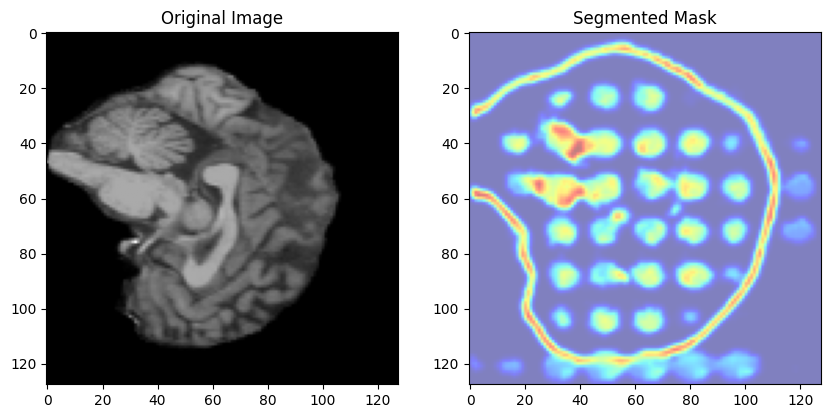

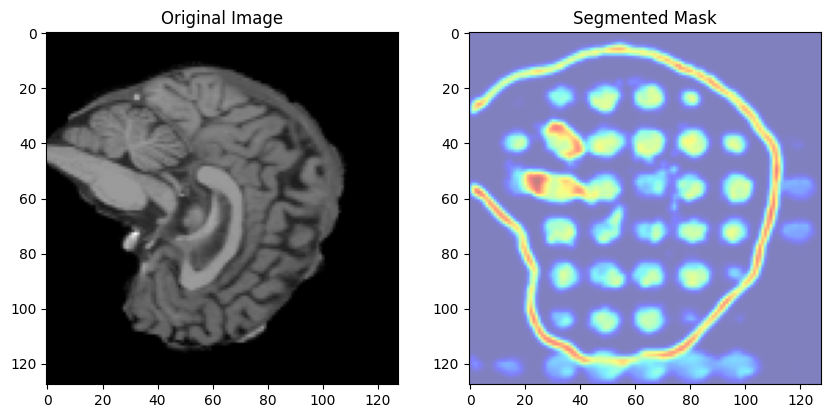

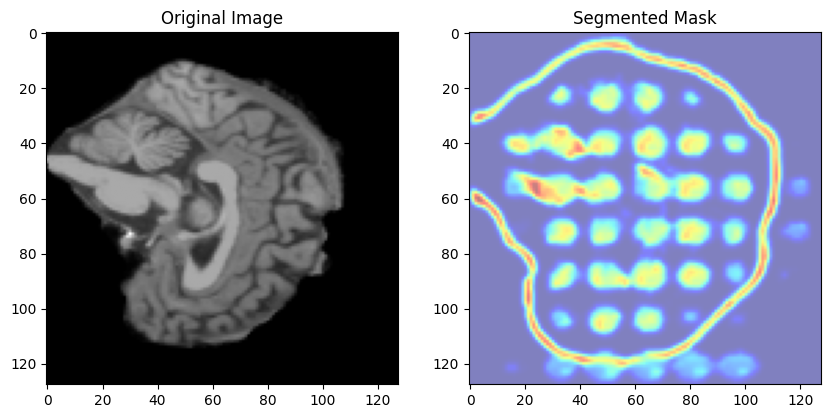

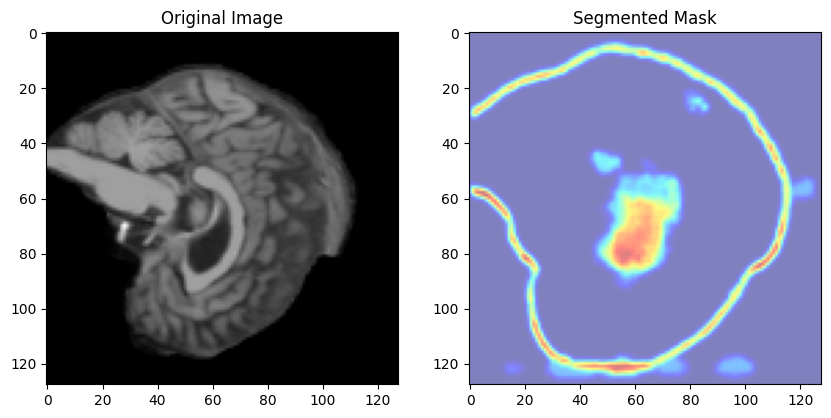

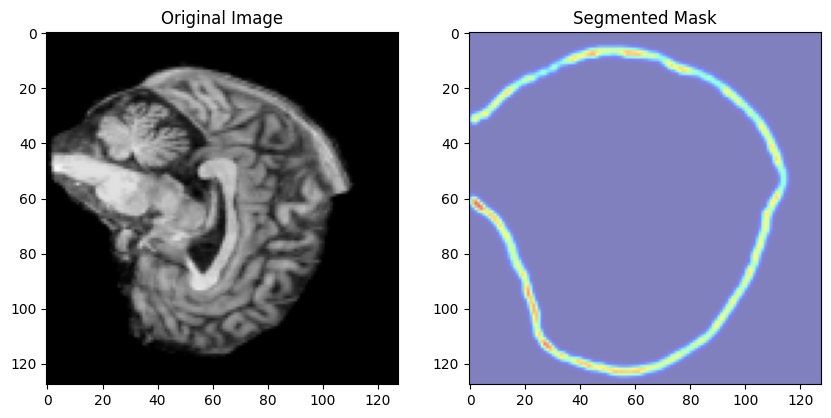

...

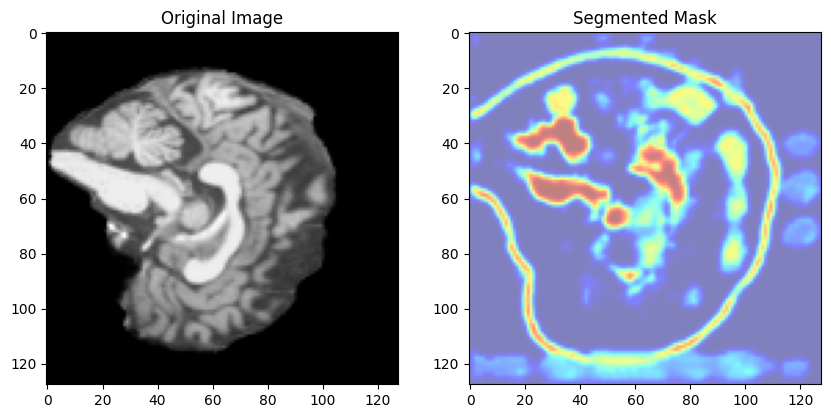

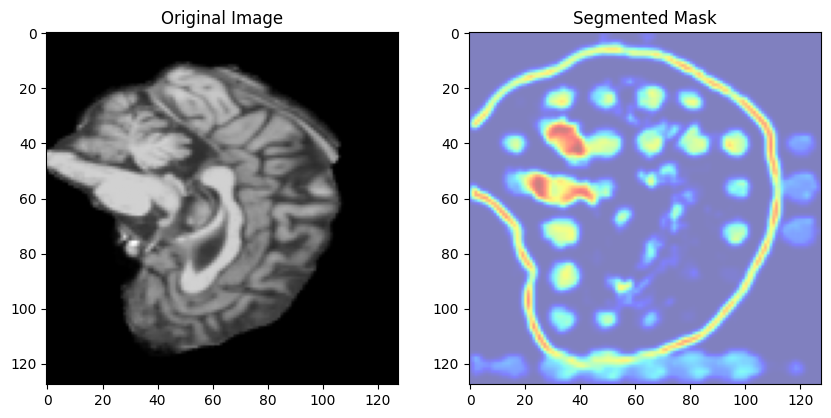

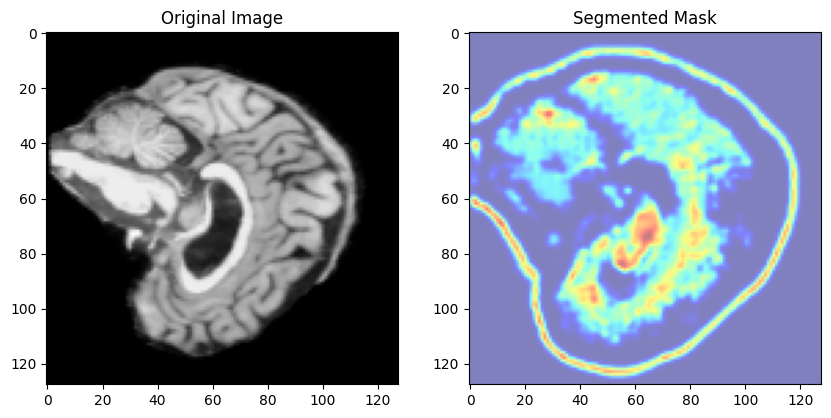

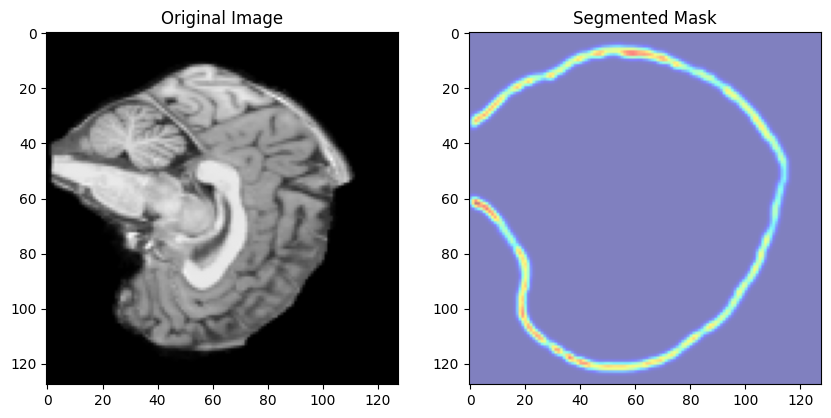

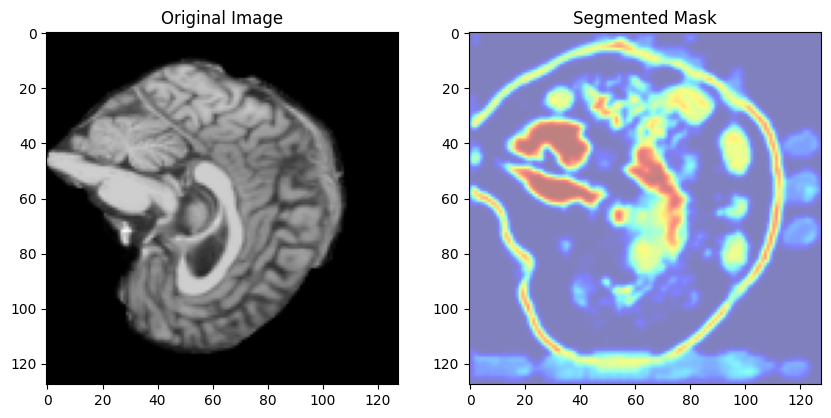

Segmentation completed. Processed masks saved.


In [ ]:
def apply_postprocessing(mask):
    mask = mask.squeeze().cpu().numpy()
    mask = np.argmax(mask, axis=0)
    
    for class_id in range(1, mask.max() + 1):
        binary_mask = (mask == class_id).astype(np.uint8)
        binary_mask = binary_fill_holes(binary_mask)
        binary_mask = binary_closing(binary_mask, structure=np.ones((3, 3, 3)))
        labeled_mask, num_features = label(binary_mask)
        
        if num_features > 1:
            largest_component = np.argmax(np.bincount(labeled_mask.flat)[1:]) + 1
            binary_mask = (labeled_mask == largest_component).astype(np.uint8)
        
        mask = np.where(mask == class_id, binary_mask * class_id, mask)

    mask = gaussian_filter(mask.astype(float), sigma=1)
    return mask

save_dir = "E:/test_results"
os.makedirs(save_dir, exist_ok=True)

def run_inference(test_dataloader, save_dir):
    for i, (image, _) in enumerate(test_dataloader):  # Ignore masks in test dataset
        image = image.to(device, dtype=torch.float32)
        
        with torch.no_grad():
            output = model(image)
            output = F.softmax(output, dim=1)
        
        processed_mask = apply_postprocessing(output)
        
        output_nifti = nib.Nifti1Image(processed_mask.astype(np.float32), affine=np.eye(4))
        nib.save(output_nifti, os.path.join(save_dir, f"segmented_{i}.nii.gz"))
        
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(image.squeeze().cpu().numpy()[image.shape[2]//2], cmap='gray')
        plt.title("Original Image")

        plt.subplot(1, 2, 2)
        plt.imshow(processed_mask[processed_mask.shape[2]//2], cmap='jet', alpha=0.5)
        plt.title("Segmented Mask")
        plt.show()

    print("Segmentation completed. Processed masks saved.")

run_inference(test_dataloader, save_dir)

In [ ]:
mask_dir = r"E:\temp_extracted_masks"
output_csv = "segmentation_features.csv"

def extract_features(mask_path):
    try:
        mask_nifti = nib.load(mask_path)
        mask = mask_nifti.get_fdata()

        if mask is None or mask.size == 0:
            print(f" Empty or invalid mask: {mask_path}")
            return None

        # Get nonzero voxel mask
        nonzero_mask = mask > 0

        # Compute volume (number of voxels)
        volume = np.sum(nonzero_mask)

        # Compute intensity statistics (mean, std of nonzero voxels)
        mean_intensity = np.mean(mask[nonzero_mask]) if volume > 0 else 0
        std_intensity = np.std(mask[nonzero_mask]) if volume > 0 else 0

        return {"Mask Name": os.path.basename(mask_path), "Volume": volume, "Mean Intensity": mean_intensity, "Std Intensity": std_intensity}

    except Exception as e:
        print(f" Error processing {mask_path}: {e}")
        return None

mask_files = [os.path.join(mask_dir, f) for f in os.listdir(mask_dir) if f.endswith(".nii") or f.endswith(".nii.gz")]

if not mask_files:
    print(" No NIfTI files found! Check the folder path.")
else:
    print(f" Found {len(mask_files)} NIfTI files for processing.")

features_list = []
print("Extracting segmentation features...")
for mask_path in tqdm(mask_files, desc="Processing", unit="mask"):
    features = extract_features(mask_path)
    if features:
        features_list.append(features)

if features_list:
    df = pd.DataFrame(features_list)
    
    scaler = StandardScaler()
    df[["Volume", "Mean Intensity", "Std Intensity"]] = scaler.fit_transform(df[["Volume", "Mean Intensity", "Std Intensity"]])

    df.to_csv(output_csv, index=False)
    print(f"Feature extraction complete. Data saved to {output_csv}")
else:
    print("No valid features extracted.")

✅ Found 144 NIfTI files for processing.
Extracting segmentation features...


Processing: 100%|██████████| 144/144 [00:09<00:00, 14.92mask/s]

✅ Feature extraction complete. Data saved to segmentation_features.csv


Finding optimal cluster count...


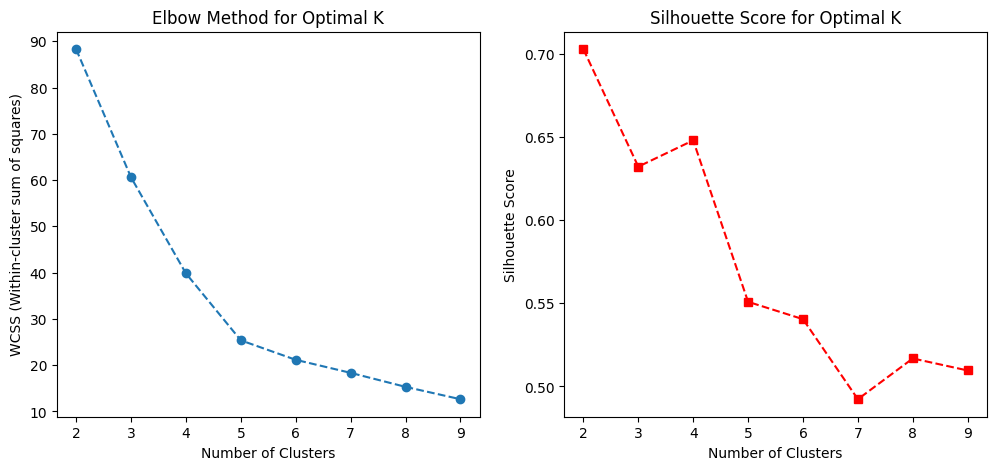

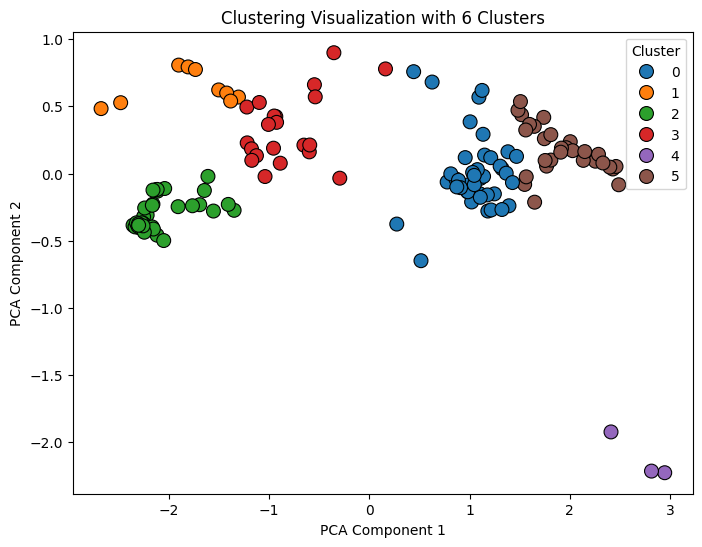

✅ Clustering complete! Results saved to segmentation_clusters.csv


In [ ]:
df = pd.read_csv("segmentation_features.csv")

feature_cols = ["Volume", "Mean Intensity", "Std Intensity"]
X = df[feature_cols]

# Standardize features (already normalized but ensuring proper scaling)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

wcss = [] 
silhouette_scores = []

print("Finding optimal cluster count...")
for k in range(2, 10):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    labels = kmeans.fit_predict(X_scaled)
    
    wcss.append(kmeans.inertia_)
    silhouette_scores.append(silhouette_score(X_scaled, labels))

# Plot Elbow method results
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(range(2, 10), wcss, marker="o", linestyle="--")
plt.xlabel("Number of Clusters")
plt.ylabel("WCSS (Within-cluster sum of squares)")
plt.title("Elbow Method for Optimal K")

# Plot Silhouette scores
plt.subplot(1, 2, 2)
plt.plot(range(2, 10), silhouette_scores, marker="s", linestyle="--", color="r")
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Score")
plt.title("Silhouette Score for Optimal K")
plt.show()

optimal_k = int(input("Enter the optimal number of clusters based on the Elbow/Silhouette method: "))

# Apply K-Means clustering
kmeans = KMeans(n_clusters=optimal_k, random_state=42, n_init=10)
df["Cluster"] = kmeans.fit_predict(X_scaled)

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)
df["PCA1"] = X_pca[:, 0]
df["PCA2"] = X_pca[:, 1]

plt.figure(figsize=(8, 6))
sns.scatterplot(x="PCA1", y="PCA2", hue="Cluster", data=df, palette="tab10", s=100, edgecolor="k")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.title(f"Clustering Visualization with {optimal_k} Clusters")
plt.legend(title="Cluster")
plt.show()

df.to_csv("segmentation_clusters.csv", index=False)
print(" Clustering complete! Results saved to segmentation_clusters.csv")

In [ ]:
df = pd.read_csv("segmentation_clusters.csv")

print("Data Loaded. Columns:", df.columns)

if "Cluster" not in df.columns:
    raise ValueError("'Cluster' column not found! Ensure clustering was performed.")

feature_cols = ["Volume", "Mean Intensity", "Std Intensity", "PCA1", "PCA2"]
anova_results = {}

# Perform ANOVA & Kruskal-Wallis Test
for feature in feature_cols:
    groups = [df[df["Cluster"] == cluster][feature] for cluster in df["Cluster"].unique()]
    
    if all(len(g) > 1 for g in groups):
        f_stat, p_value_anova = stats.f_oneway(*groups)  # ANOVA
        h_stat, p_value_kruskal = stats.kruskal(*groups)  # Kruskal-Wallis
    else:
        p_value_anova = np.nan
        p_value_kruskal = np.nan

    anova_results[feature] = {
        "ANOVA F-statistic": f_stat if not np.isnan(p_value_anova) else "N/A",
        "ANOVA p-value": p_value_anova,
        "Kruskal-Wallis H-statistic": h_stat if not np.isnan(p_value_kruskal) else "N/A",
        "Kruskal-Wallis p-value": p_value_kruskal
    }

anova_df = pd.DataFrame.from_dict(anova_results, orient="index")

anova_df.to_csv("anova_kruskal_results.csv", index=True)
print("\n📊 ANOVA & Kruskal-Wallis results saved to 'anova_kruskal_results.csv'.")

# Post-hoc Tukey's HSD test (only for significant ANOVA results)
for feature in feature_cols:
    if anova_results[feature]["ANOVA p-value"] < 0.05:
        print(f"\n📌 Performing Tukey's HSD test for {feature} (p < 0.05)...")
        tukey = pairwise_tukeyhsd(df[feature], df["Cluster"], alpha=0.05)
        print(tukey)

        with open(f"tukey_{feature}.txt", "w") as f:
            f.write(str(tukey))
        print(f"✅ Tukey's HSD results saved for {feature}.")


✅ Data Loaded. Columns: Index(['Mask Name', 'Volume', 'Mean Intensity', 'Std Intensity', 'Cluster',
       'PCA1', 'PCA2'],
      dtype='object')

📊 ANOVA & Kruskal-Wallis results saved to 'anova_kruskal_results.csv'.

📌 Performing Tukey's HSD test for Volume (p < 0.05)...
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
     0      1  -1.0137    0.0 -1.2737 -0.7538   True
     0      2  -2.0413    0.0 -2.1992 -1.8833   True
     0      3  -0.7442    0.0 -0.9323 -0.5561   True
     0      4  -0.5325 0.0053 -0.9569  -0.108   True
     0      5   0.5831    0.0  0.4136  0.7526   True
     1      2  -1.0275    0.0 -1.2921 -0.7629   True
     1      3   0.2695 0.0727 -0.0141  0.5531  False
     1      4   0.4813 0.0448  0.0067  0.9558   True
     1      5   1.5969    0.0  1.3253  1.8685   True
     2      3    1.297    0.0  1.1025  1.4915   True
     2      4   1.5088    0.0  1.0815

C:\Users\NARINDER\AppData\Local\Temp\ipykernel_13152\1468993748.py:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Cluster", y=metric, data=df, palette="Set2")
C:\Users\NARINDER\AppData\Local\Temp\ipykernel_13152\1468993748.py:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Cluster", y=metric, data=df, palette="Set2")
C:\Users\NARINDER\AppData\Local\Temp\ipykernel_13152\1468993748.py:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Cluster", y=metric, data=df, palette="Set2")


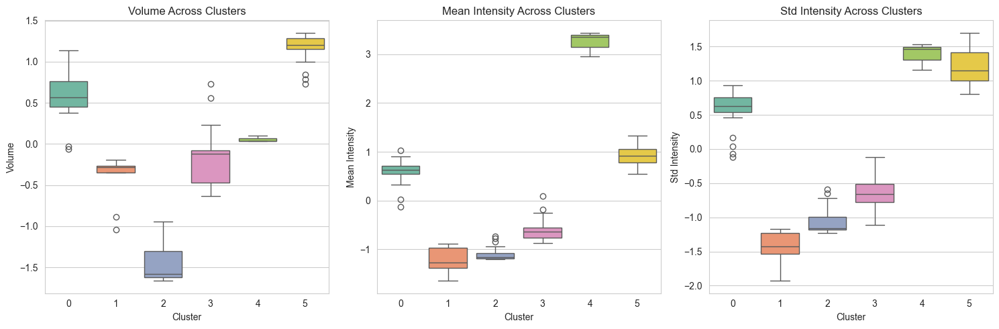

C:\Users\NARINDER\AppData\Local\Temp\ipykernel_13152\1468993748.py:29: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.swarmplot(x="Cluster", y=metric, data=df, palette="husl", size=4)
c:\Users\NARINDER\Desktop\Assignment_AI\ai\Lib\site-packages\seaborn\categorical.py:3399: UserWarning: 10.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
C:\Users\NARINDER\AppData\Local\Temp\ipykernel_13152\1468993748.py:29: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.swarmplot(x="Cluster", y=metric, data=df, palette="husl", size=4)
c:\Users\NARINDER\Desktop\Assignment_AI\ai\Lib\site-packages\seaborn\categorical.py:3399: UserWarning: 10.

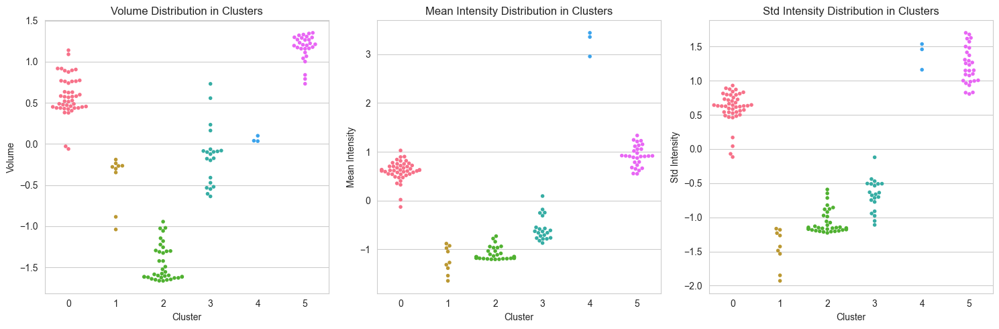

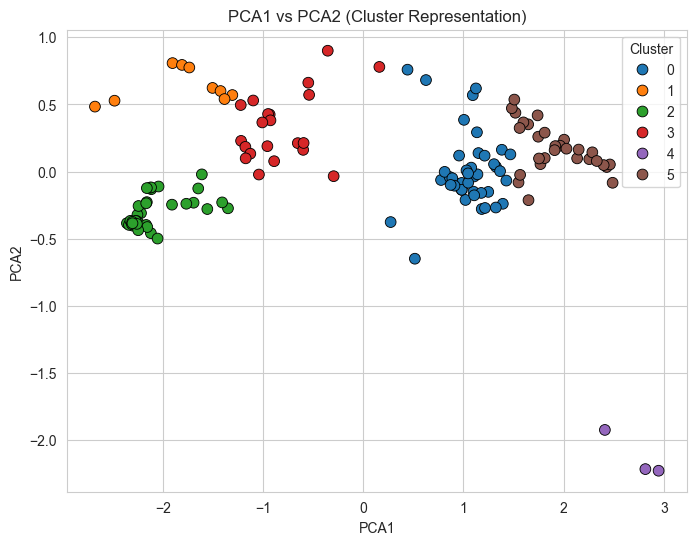

In [ ]:
df = pd.read_csv("segmentation_clusters.csv")

sns.set_style("whitegrid")

metrics = ["Volume", "Mean Intensity", "Std Intensity"]
pca_components = ["PCA1", "PCA2"]

# Boxplots for Volume, Mean Intensity, and Std Intensity across clusters
plt.figure(figsize=(15, 5))
for i, metric in enumerate(metrics, 1):
    plt.subplot(1, 3, i)
    sns.boxplot(x="Cluster", y=metric, data=df, palette="Set2")
    plt.title(f"{metric} Across Clusters")
plt.tight_layout()
plt.savefig("boxplots.png")
plt.show()

# Swarm Plots for better distribution visualization
plt.figure(figsize=(15, 5))
for i, metric in enumerate(metrics, 1):
    plt.subplot(1, 3, i)
    sns.swarmplot(x="Cluster", y=metric, data=df, palette="husl", size=4)
    plt.title(f"{metric} Distribution in Clusters")
plt.tight_layout()
plt.savefig("swarm_plots.png")
plt.show()

# Scatter Plot for PCA1 vs PCA2 (Color-coded by Cluster)
plt.figure(figsize=(8, 6))
sns.scatterplot(x="PCA1", y="PCA2", hue="Cluster", data=df, palette="tab10", s=60, edgecolor="black")
plt.title("PCA1 vs PCA2 (Cluster Representation)")
plt.legend(title="Cluster")
plt.savefig("pca_scatter.png")
plt.show()